In [1]:
import pandas as pd
from sklearn import metrics
from sklearn.metrics import confusion_matrix, r2_score,mean_squared_error,classification_report
from sklearn.preprocessing import normalize,StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import SelectPercentile,f_regression
from sklearn.model_selection import train_test_split, GridSearchCV,KFold, cross_val_score,cross_val_predict
from sklearn.linear_model import LinearRegression,ElasticNetCV,ElasticNet
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np


import cufflinks as cf
import plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
cf.go_offline()


In [2]:
df_train = pd.read_csv(r'/Users/allen/Desktop/MSDS/QTW/qtw_smu/Case Study 1/superconduct/train.csv')
df_unique_m = pd.read_csv(r'/Users/allen/Desktop/MSDS/QTW/qtw_smu/Case Study 1/superconduct/unique_m.csv')


In [3]:
#merge two dataframes on indexes
df_merge = pd.merge(df_train, df_unique_m, left_index=True, right_index=True)

In [4]:
#delete duplicate and unused column
df_merge = df_merge.drop(['critical_temp_y','material'], axis=1)

#rename column from merge
df_merge.rename(columns = {'critical_temp_x':'critical_temp'}, inplace = True)

In [5]:
df_merge.head()

,number_of_elements,mean_atomic_mass,wtd_mean_atomic_mass,gmean_atomic_mass,wtd_gmean_atomic_mass,entropy_atomic_mass,wtd_entropy_atomic_mass,range_atomic_mass,wtd_range_atomic_mass,std_atomic_mass,...,Ir,Pt,Au,Hg,Tl,Pb,Bi,Po,At,Rn
0,4,88.944468,57.862692,66.361592,36.116612,1.181795,1.062396,122.90607,31.794921,51.968828,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
1,5,92.729214,58.518416,73.132787,36.396602,1.449309,1.057755,122.90607,36.161939,47.094633,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
2,4,88.944468,57.885242,66.361592,36.122509,1.181795,0.975980,122.90607,35.741099,51.968828,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
3,4,88.944468,57.873967,66.361592,36.119560,1.181795,1.022291,122.90607,33.768010,51.968828,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0
4,4,88.944468,57.840143,66.361592,36.110716,1.181795,1.129224,122.90607,27.848743,51.968828,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0


In [6]:
#show all columns..
pd.set_option('display.max_columns', None)

In [7]:
df_train.head()

,number_of_elements,mean_atomic_mass,wtd_mean_atomic_mass,gmean_atomic_mass,wtd_gmean_atomic_mass,entropy_atomic_mass,wtd_entropy_atomic_mass,range_atomic_mass,wtd_range_atomic_mass,std_atomic_mass,wtd_std_atomic_mass,mean_fie,wtd_mean_fie,gmean_fie,wtd_gmean_fie,entropy_fie,wtd_entropy_fie,range_fie,wtd_range_fie,std_fie,wtd_std_fie,mean_atomic_radius,wtd_mean_atomic_radius,gmean_atomic_radius,wtd_gmean_atomic_radius,entropy_atomic_radius,wtd_entropy_atomic_radius,range_atomic_radius,wtd_range_atomic_radius,std_atomic_radius,wtd_std_atomic_radius,mean_Density,wtd_mean_Density,gmean_Density,wtd_gmean_Density,entropy_Density,wtd_entropy_Density,range_Density,wtd_range_Density,std_Density,wtd_std_Density,mean_ElectronAffinity,wtd_mean_ElectronAffinity,gmean_ElectronAffinity,wtd_gmean_ElectronAffinity,entropy_ElectronAffinity,wtd_entropy_ElectronAffinity,range_ElectronAffinity,wtd_range_ElectronAffinity,std_ElectronAffinity,wtd_std_ElectronAffinity,mean_FusionHeat,wtd_mean_FusionHeat,gmean_FusionHeat,wtd_gmean_FusionHeat,entropy_FusionHeat,wtd_entropy_FusionHeat,range_FusionHeat,wtd_range_FusionHeat,std_FusionHeat,wtd_std_FusionHeat,mean_ThermalConductivity,wtd_mean_ThermalConductivity,gmean_ThermalConductivity,wtd_gmean_ThermalConductivity,entropy_ThermalConductivity,wtd_entropy_ThermalConductivity,range_ThermalConductivity,wtd_range_ThermalConductivity,std_ThermalConductivity,wtd_std_ThermalConductivity,mean_Valence,wtd_mean_Valence,gmean_Valence,wtd_gmean_Valence,entropy_Valence,wtd_entropy_Valence,range_Valence,wtd_range_Valence,std_Valence,wtd_std_Valence,critical_temp
0,4,88.944468,57.862692,66.361592,36.116612,1.181795,1.062396,122.90607,31.794921,51.968828,53.622535,775.425,1010.268571,718.152900,938.016780,1.305967,0.791488,810.6,735.985714,323.811808,355.562967,160.25,105.514286,136.126003,84.528423,1.259244,1.207040,205,42.914286,75.237540,69.235569,4654.35725,2961.502286,724.953211,53.543811,1.033129,0.814598,8958.571,1579.583429,3306.162897,3572.596624,81.8375,111.727143,60.123179,99.414682,1.159687,0.787382,127.05,80.987143,51.433712,42.558396,6.9055,3.846857,3.479475,1.040986,1.088575,0.994998,12.878,1.744571,4.599064,4.666920,107.756645,61.015189,7.062488,0.621979,0.308148,0.262848,399.97342,57.127669,168.854244,138.517163,2.25,2.257143,2.213364,2.219783,1.368922,1.066221,1,1.085714,0.433013,0.437059,29.0
1,5,92.729214,58.518416,73.132787,36.396602,1.449309,1.057755,122.90607,36.161939,47.094633,53.979870,766.440,1010.612857,720.605511,938.745413,1.544145,0.807078,810.6,743.164286,290.183029,354.963511,161.20,104.971429,141.465215,84.370167,1.508328,1.204115,205,50.571429,67.321319,68.008817,5821.48580,3021.016571,1237.095080,54.095718,1.314442,0.914802,10488.571,1667.383429,3767.403176,3632.649185,90.8900,112.316429,69.833315,101.166398,1.427997,0.838666,127.05,81.207857,49.438167,41.667621,7.7844,3.796857,4.403790,1.035251,1.374977,1.073094,12.878,1.595714,4.473363,4.603000,172.205316,61.372331,16.064228,0.619735,0.847404,0.567706,429.97342,51.413383,198.554600,139.630922,2.00,2.257143,1.888175,2.210679,1.557113,1.047221,2,1.128571,0.632456,0.468606,26.0
2,4,88.944468,57.885242,66.361592,36.122509,1.181795,0.975980,122.90607,35.741099,51.968828,53.656268,775.425,1010.820000,718.152900,939.009036,1.305967,0.773620,810.6,743.164286,323.811808,354.804183,160.25,104.685714,136.126003,84.214573,1.259244,1.132547,205,49.314286,75.237540,67.797712,4654.35725,2999.159429,724.953211,53.974022,1.033129,0.760305,8958.571,1667.383429,3306.162897,3592.019281,81.8375,112.213571,60.123179,101.082152,1.159687,0.786007,127.05,81.207857,51.433712,41.639878,6.9055,3.822571,3.479475,1.037439,1.088575,0.927479,12.878,1.757143,4.599064,4.649635,107.756645,60.943760,7.062488,0.619095,0.308148,0.250477,399.97342,57.127669,168.854244,138.540613,2.25,2.271429,2.213364,2.232679,1.368922,1.029175,1,1.114286,0.433013,0.444697,19.0
3,4,88.944468,57.873967,66.361592,36.119560,1.181795,1.022291,122.90607,33.768010,51.968828,53.639405,775.425,1

In [8]:
df_unique_m.head()

,H,He,Li,Be,B,C,N,O,F,Ne,Na,Mg,Al,Si,P,S,Cl,Ar,K,Ca,Sc,Ti,V,Cr,Mn,Fe,Co,Ni,Cu,Zn,Ga,Ge,As,Se,Br,Kr,Rb,Sr,Y,Zr,Nb,Mo,Tc,Ru,Rh,Pd,Ag,Cd,In,Sn,Sb,Te,I,Xe,Cs,Ba,La,Ce,Pr,Nd,Pm,Sm,Eu,Gd,Tb,Dy,Ho,Er,Tm,Yb,Lu,Hf,Ta,W,Re,Os,Ir,Pt,Au,Hg,Tl,Pb,Bi,Po,At,Rn,critical_temp,material
0,0.0,0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.20,1.80,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,29.0,Ba0.2La1.8Cu1O4
1,0.0,0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.9,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.1,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.10,1.90,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,26.0,Ba0.1La1.9Ag0.1Cu0.9O4
2,0.0,0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.10,1.90,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,19.0,Ba0.1La1.9Cu1O4
3,0.0,0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.15,1.85,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,22.0,Ba0.15La1.85Cu1O4
4,0.0,0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.30,1.70,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,23.0,Ba0.3La1.7Cu1O4


In [9]:
df_train_shape = df_train.shape
df_unique_m_shape = df_unique_m.shape
df_merge_shape = df_merge.shape
print(f'Train DataFrame Shape: {df_train_shape}')
print(f'Unique_m DataFrame Shape:{df_unique_m_shape}')
print(f'Merged DataFrame Shape:{df_merge_shape}')

Train DataFrame Shape: (21263, 82)
Unique_m DataFrame Shape:(21263, 88)
Merged DataFrame Shape:(21263, 168)


In [10]:
df_train.info(verbose = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21263 entries, 0 to 21262
Data columns (total 82 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   number_of_elements               21263 non-null  int64  
 1   mean_atomic_mass                 21263 non-null  float64
 2   wtd_mean_atomic_mass             21263 non-null  float64
 3   gmean_atomic_mass                21263 non-null  float64
 4   wtd_gmean_atomic_mass            21263 non-null  float64
 5   entropy_atomic_mass              21263 non-null  float64
 6   wtd_entropy_atomic_mass          21263 non-null  float64
 7   range_atomic_mass                21263 non-null  float64
 8   wtd_range_atomic_mass            21263 non-null  float64
 9   std_atomic_mass                  21263 non-null  float64
 10  wtd_std_atomic_mass              21263 non-null  float64
 11  mean_fie                         21263 non-null  float64
 12  wtd_mean_fie      

In [11]:
df_unique_m.info(verbose = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21263 entries, 0 to 21262
Data columns (total 88 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   H              21263 non-null  float64
 1   He             21263 non-null  int64  
 2   Li             21263 non-null  float64
 3   Be             21263 non-null  float64
 4   B              21263 non-null  float64
 5   C              21263 non-null  float64
 6   N              21263 non-null  float64
 7   O              21263 non-null  float64
 8   F              21263 non-null  float64
 9   Ne             21263 non-null  int64  
 10  Na             21263 non-null  float64
 11  Mg             21263 non-null  float64
 12  Al             21263 non-null  float64
 13  Si             21263 non-null  float64
 14  P              21263 non-null  float64
 15  S              21263 non-null  float64
 16  Cl             21263 non-null  float64
 17  Ar             21263 non-null  int64  
 18  K     

In [12]:
df_merge.info(verbose = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21263 entries, 0 to 21262
Data columns (total 168 columns):
 #    Column                           Dtype  
---   ------                           -----  
 0    number_of_elements               int64  
 1    mean_atomic_mass                 float64
 2    wtd_mean_atomic_mass             float64
 3    gmean_atomic_mass                float64
 4    wtd_gmean_atomic_mass            float64
 5    entropy_atomic_mass              float64
 6    wtd_entropy_atomic_mass          float64
 7    range_atomic_mass                float64
 8    wtd_range_atomic_mass            float64
 9    std_atomic_mass                  float64
 10   wtd_std_atomic_mass              float64
 11   mean_fie                         float64
 12   wtd_mean_fie                     float64
 13   gmean_fie                        float64
 14   wtd_gmean_fie                    float64
 15   entropy_fie                      float64
 16   wtd_entropy_fie                  float

In [14]:
df_merge.describe()

,number_of_elements,mean_atomic_mass,wtd_mean_atomic_mass,gmean_atomic_mass,wtd_gmean_atomic_mass,entropy_atomic_mass,wtd_entropy_atomic_mass,range_atomic_mass,wtd_range_atomic_mass,std_atomic_mass,wtd_std_atomic_mass,mean_fie,wtd_mean_fie,gmean_fie,wtd_gmean_fie,entropy_fie,wtd_entropy_fie,range_fie,wtd_range_fie,std_fie,wtd_std_fie,mean_atomic_radius,wtd_mean_atomic_radius,gmean_atomic_radius,wtd_gmean_atomic_radius,entropy_atomic_radius,wtd_entropy_atomic_radius,range_atomic_radius,wtd_range_atomic_radius,std_atomic_radius,wtd_std_atomic_radius,mean_Density,wtd_mean_Density,gmean_Density,wtd_gmean_Density,entropy_Density,wtd_entropy_Density,range_Density,wtd_range_Density,std_Density,wtd_std_Density,mean_ElectronAffinity,wtd_mean_ElectronAffinity,gmean_ElectronAffinity,wtd_gmean_ElectronAffinity,entropy_ElectronAffinity,wtd_entropy_ElectronAffinity,range_ElectronAffinity,wtd_range_ElectronAffinity,std_ElectronAffinity,wtd_std_ElectronAffinity,mean_FusionHeat,wtd_mean_FusionHeat,gmean_FusionHeat,wtd_gmean_FusionHeat,entropy_FusionHeat,wtd_entropy_FusionHeat,range_FusionHeat,wtd_range_FusionHeat,std_FusionHeat,wtd_std_FusionHeat,mean_ThermalConductivity,wtd_mean_ThermalConductivity,gmean_ThermalConductivity,wtd_gmean_ThermalConductivity,entropy_ThermalConductivity,wtd_entropy_ThermalConductivity,range_ThermalConductivity,wtd_range_ThermalConductivity,std_ThermalConductivity,wtd_std_ThermalConductivity,mean_Valence,wtd_mean_Valence,gmean_Valence,wtd_gmean_Valence,entropy_Valence,wtd_entropy_Valence,range_Valence,wtd_range_Valence,std_Valence,wtd_std_Valence,critical_temp,H,He,Li,Be,B,C,N,O,F,Ne,Na,Mg,Al,Si,P,S,Cl,Ar,K,Ca,Sc,Ti,V,Cr,Mn,Fe,Co,Ni,Cu,Zn,Ga,Ge,As,Se,Br,Kr,Rb,Sr,Y,Zr,Nb,Mo,Tc,Ru,Rh,Pd,Ag,Cd,In,Sn,Sb,Te,I,Xe,Cs,Ba,La,Ce,Pr,Nd,Pm,Sm,Eu,Gd,Tb,Dy,Ho,Er,Tm,Yb,Lu,Hf,Ta,W,Re,Os,Ir,Pt,Au,Hg,Tl,Pb,Bi,Po,At,Rn
count,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.0,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.0,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.0,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.0,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.0,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.0,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.000000,21263.0,21263.0,21263.0
mean,4.11522

In [15]:

df_merge['critical_temp'].iplot(
    kind='hist',
    bins=100,
    xTitle='Critical Temperature',
    linecolor='black',
    yTitle='count',
    title='Histogram of Critical Temperature')

In [18]:
scatter_cols = ['number_of_elements','mean_atomic_mass','mean_atomic_radius','mean_ThermalConductivity','critical_temp']
df_scatter = df_merge[scatter_cols]
df_scatter.scatter_matrix()

## Begin Modeling

In [195]:
# Subset of columns to transform

sc = StandardScaler()
# Overwrite old columns with transformed columns
df_scaled = pd.DataFrame(sc.fit_transform(df_merge),columns = df_merge.columns)

In [196]:
#Specififying Stratified Kfold for cv.
kfcv = KFold(n_splits=10,random_state=0,shuffle=True)


In [197]:
lr = LinearRegression(n_jobs=-1)
target_col = ['critical_temp']
feature_cols = df_scaled.loc[:, ~df_scaled.columns.isin(target_col)].columns
y = df_scaled.critical_temp
X = df_scaled[feature_cols]

In [198]:
df_scaled.head()

,number_of_elements,mean_atomic_mass,wtd_mean_atomic_mass,gmean_atomic_mass,wtd_gmean_atomic_mass,entropy_atomic_mass,wtd_entropy_atomic_mass,range_atomic_mass,wtd_range_atomic_mass,std_atomic_mass,wtd_std_atomic_mass,mean_fie,wtd_mean_fie,gmean_fie,wtd_gmean_fie,entropy_fie,wtd_entropy_fie,range_fie,wtd_range_fie,std_fie,wtd_std_fie,mean_atomic_radius,wtd_mean_atomic_radius,gmean_atomic_radius,wtd_gmean_atomic_radius,entropy_atomic_radius,wtd_entropy_atomic_radius,range_atomic_radius,wtd_range_atomic_radius,std_atomic_radius,wtd_std_atomic_radius,mean_Density,wtd_mean_Density,gmean_Density,wtd_gmean_Density,entropy_Density,wtd_entropy_Density,range_Density,wtd_range_Density,std_Density,wtd_std_Density,mean_ElectronAffinity,wtd_mean_ElectronAffinity,gmean_ElectronAffinity,wtd_gmean_ElectronAffinity,entropy_ElectronAffinity,wtd_entropy_ElectronAffinity,range_ElectronAffinity,wtd_range_ElectronAffinity,std_ElectronAffinity,wtd_std_ElectronAffinity,mean_FusionHeat,wtd_mean_FusionHeat,gmean_FusionHeat,wtd_gmean_FusionHeat,entropy_FusionHeat,wtd_entropy_FusionHeat,range_FusionHeat,wtd_range_FusionHeat,std_FusionHeat,wtd_std_FusionHeat,mean_ThermalConductivity,wtd_mean_ThermalConductivity,gmean_ThermalConductivity,wtd_gmean_ThermalConductivity,entropy_ThermalConductivity,wtd_entropy_ThermalConductivity,range_ThermalConductivity,wtd_range_ThermalConductivity,std_ThermalConductivity,wtd_std_ThermalConductivity,mean_Valence,wtd_mean_Valence,gmean_Valence,wtd_gmean_Valence,entropy_Valence,wtd_entropy_Valence,range_Valence,wtd_range_Valence,std_Valence,wtd_std_Valence,critical_temp,H,He,Li,Be,B,C,N,O,F,Ne,Na,Mg,Al,Si,P,S,Cl,Ar,K,Ca,Sc,Ti,V,Cr,Mn,Fe,Co,Ni,Cu,Zn,Ga,Ge,As,Se,Br,Kr,Rb,Sr,Y,Zr,Nb,Mo,Tc,Ru,Rh,Pd,Ag,Cd,In,Sn,Sb,Te,I,Xe,Cs,Ba,La,Ce,Pr,Nd,Pm,Sm,Eu,Gd,Tb,Dy,Ho,Er,Tm,Yb,Lu,Hf,Ta,W,Re,Os,Ir,Pt,Au,Hg,Tl,Pb,Bi,Po,At,Rn
0,-0.080058,0.046733,-0.451651,-0.158850,-0.611819,0.044358,-0.003707,0.133725,-0.053039,0.378186,0.609240,0.066413,0.975930,-0.246687,0.878746,0.017791,-0.404893,0.769935,1.126902,0.983780,1.028054,0.112519,-1.014057,-0.376757,-1.017410,-0.022674,0.186424,0.97628,-0.241461,1.032248,0.667951,-0.511855,-0.715776,-0.738756,-0.770736,-0.114783,-0.129595,0.071547,-0.551678,-0.066174,0.157235,0.178972,0.588979,0.198701,0.853094,0.260458,0.058134,0.107659,0.756628,0.115985,-0.090605,-0.654041,-0.700409,-0.661407,-0.692887,-0.012682,0.218671,-0.405544,-0.567204,-0.429486,-0.418582,0.468622,-0.451114,-0.668821,-0.663995,-1.286879,-0.870857,0.939383,-0.113755,1.162423,0.663693,-0.907755,-0.752156,-0.805912,-0.711705,0.186292,0.035183,-0.837959,-0.406166,-0.838372,-0.520070,-0.158267,-0.066181,0.0,-0.093592,-0.040822,-0.136524,-0.087335,-0.088312,0.259965,-0.112585,0.0,-0.087446,-0.098571,-0.054765,-0.085643,-0.060302,-0.13965,-0.0756,0.0,-0.116095,-0.28619,-0.058815,-0.057483,-0.065963,-0.024065,-0.024653,-0.214823,-0.060832,-0.091788,-0.133096,-0.034797,-0.066366,-0.080838,-0.144232,-0.116315,-0.046957,0.0,-0.064323,-0.428112,-0.412977,-0.076532,-0.091241,-0.070225,-0.035396,-0.071822,-0.067675,-0.05472,-0.046681,-0.013289,-0.094802,-0.064123,-0.055068,-0.056392,-0.053622,0.0,-0.053152,-0.374711,0.661440,-0.177088,-0.032366,-0.176567,0.0,-0.120064,-0.117687,-0.153723,-0.044127,-0.09156,-0.089455,-0.108186,-0.068296,-0.059197,-0.096978,-0.043874,-0.042387,-0.063318,-0.032448,-0.079756,-0.071179,-0.110785,-0.028601,-0.178115,-0.176113,-0.154764,-0.306457,0.0,0.0,0.0
1,0.614744,0.174269,-0.432071,0.059368,-0.604180,0.777430,-0.015267,0.133725,0.108900,0.134901,0.627122,-0.036288,0.978333,-0.215374,0.884829,0.641414,-0.358216,0.769935,1.158944,0.677964,1.023368,0.159673,-1.032906,-0.135059,-1.021826,0.640837,0.179239,0.97628,-0.022801,0.686529,0.619451,-0.101864,-0.697301,-0.600458,-0.770597,0.706934,0.183784,0.444989,-0.515071,0.209426,0.194494,0.505763,0.607237,0.533456,0.908444,1.041830,0.237464,0.107659,0.764340,0.024193,-0.134209,-0.576262,-0.703911,-0.569579,-0.693324,0.749180,0.429674,-0.405544,-0.580246,-0.443982,-0.427353,

In [199]:
#create test train split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [200]:
#checking shape of data
print('X_train shape: ',X_train.shape,'\n')
print('X_test shape: ',X_test.shape,'\n')
print('y_train shape: ',y_train.shape,'\n')
print('y_test shape: ',y_test.shape)

X_train shape:  (17010, 167) 

X_test shape:  (4253, 167) 

y_train shape:  (17010,) 

y_test shape:  (4253,)


In [201]:
%%time
# Grid search for Logistic Regression task 1

lr_grid={"l1_ratio":np.arange(0.0,1.0,0.1), 
      "alpha": [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 0.0, 1.0, 10.0, 100.0]
      }

model=ElasticNet(random_state = 0)

model_gs=GridSearchCV(model,
                       lr_grid,
                       cv = kfcv,
                       n_jobs=-1,
                       verbose = 1)

model_gs.fit(X_train,y_train)

print('GridSearchCV Metrics:\n__________________________\n')
print('Tuned hpyerparameters :(best parameters) ',model_gs.best_params_)
print('Model Score :',model_gs.best_score_)
print('\nEnd GridSearchCV Metrics\n__________________________\n')

Fitting 10 folds for each of 90 candidates, totalling 900 fits


/Users/allen/virtualenvs/QTW/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.794e+03, tolerance: 1.529e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.
  model = cd_fast.enet_coordinate_descent(
/Users/allen/virtualenvs/QTW/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.788e+03, tolerance: 1.529e+00 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers 

GridSearchCV Metrics:
__________________________

Tuned hpyerparameters :(best parameters)  {'alpha': 0.01, 'l1_ratio': 0.2}
Accuracy : 0.7433811091040069

End GridSearchCV Metrics
__________________________

CPU times: user 8.57 s, sys: 5.44 s, total: 14 s
Wall time: 3min 2s


In [202]:
#imput GridSearch Output in Model
model = ElasticNet(l1_ratio=0.2,alpha = 0.01,random_state=0)
model.fit(X_train,y_train)

y_predict = model.predict(X_test)

In [203]:
model_mse = (mean_squared_error(y_true=y_test,y_pred=y_predict))
print(f'Elastic Net Mean Squared Error: {model_mse}')

r2 =r2_score(y_test,y_predict)
print(f'Elastic Net R2 Score: {r2}')


Elastic Net Mean Squared Error: 0.39282948863494777
Elastic Net R2 Score: 0.6039976355165989


In [204]:
#print intercept and coefficients
lr_coef = model.coef_
lr_features_coef = pd.DataFrame(list(zip(X_train,lr_coef)))
lr_features_coef.columns = ['Feature','Coefficient']
lr_intercept = model.intercept_

print(f'Logistic Regression Intercept: {lr_intercept}')
print(lr_features_coef)


Logistic Regression Intercept: 0.0001203302779866338
                   Feature  Coefficient
0       number_of_elements     0.025207
1         mean_atomic_mass     0.024922
2     wtd_mean_atomic_mass    -0.050060
3        gmean_atomic_mass     0.000000
4    wtd_gmean_atomic_mass    -0.000000
..                     ...          ...
162                     Pb     0.006111
163                     Bi     0.121430
164                     Po     0.000000
165                     At     0.000000
166                     Rn     0.000000

[167 rows x 2 columns]


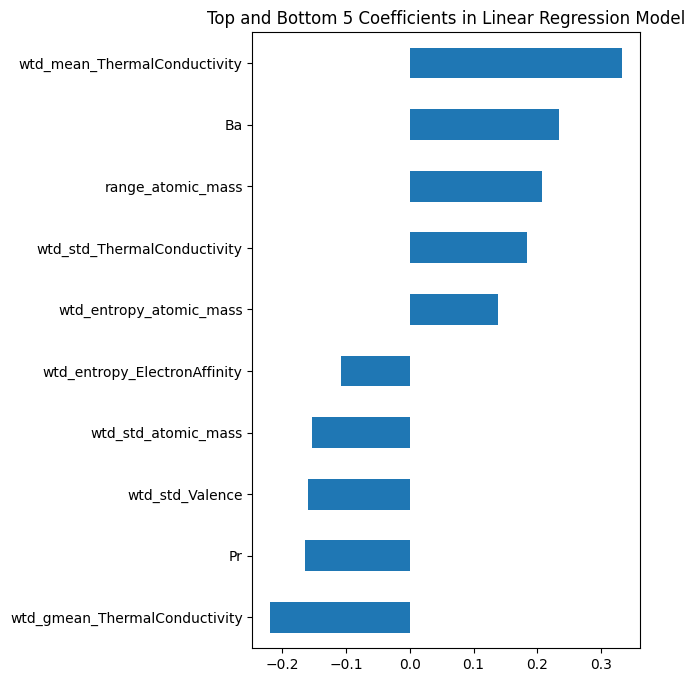

In [205]:

model_coef = pd.Series(lr_coef, index = X_train.columns)
top5_bottom5_coef = pd.concat([model_coef.sort_values().head(5),
                     model_coef.sort_values().tail(5)])

matplotlib.rcParams['figure.figsize'] = (5.0, 8.0)
top5_bottom5_coef.plot(kind = "barh")
plt.title("Top and Bottom 5 Coefficients in Linear Regression Model");

### Test out Ridge Regression model

In [212]:
%%time

from sklearn.linear_model import Ridge
# Grid search for Logistic Regression task 1

lr_ridge_grid={
      "alpha": [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 0.0, 1.0, 10.0, 100.0],
      "tol": [0.00001,0.0001,0.001, 0.01, 0.1, 1.0],
      "solver": ['lbfgs'],
      "positive": ['True']
      }

model_ridge=Ridge(random_state = 0)

model_ridge_gs=GridSearchCV(model_ridge,
                       lr_ridge_grid,
                       cv = kfcv,
                       n_jobs=-1,
                       verbose = 1)

model_ridge_gs.fit(X_train,y_train)

print('GridSearchCV Metrics:\n__________________________\n')
print('Tuned hpyerparameters :(best parameters) ',model_ridge_gs.best_params_)
print('Accuracy :',model_ridge_gs.best_score_)
print('\nEnd GridSearchCV Metrics\n__________________________\n')

Fitting 10 folds for each of 54 candidates, totalling 540 fits


/Users/allen/virtualenvs/QTW/lib/python3.9/site-packages/joblib/externals/loky/process_executor.py:702: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


GridSearchCV Metrics:
__________________________

Tuned hpyerparameters :(best parameters)  {'alpha': 1.0, 'positive': 'True', 'solver': 'lbfgs', 'tol': 1e-05}
Accuracy : 0.6595352179949149

End GridSearchCV Metrics
__________________________

CPU times: user 2.89 s, sys: 1.76 s, total: 4.65 s
Wall time: 6.72 s


In [213]:
%%time

from sklearn.linear_model import Lasso
# Grid search for Logistic Regression task 1

lr_lasso_grid={
      "alpha": [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 0.0, 1.0, 10.0, 100.0],
      "tol": [0.00001,0.0001,0.001, 0.01, 0.1, 1.0],
      "selection": ['cyclic','random'],
      "positive": ['True','False']
      }

model_lasso=Lasso(random_state = 0)

model_lasso_gs=GridSearchCV(model_lasso,
                       lr_lasso_grid,
                       cv = kfcv,
                       n_jobs=-1,
                       verbose = 1)

model_lasso_gs.fit(X_train,y_train)

print('GridSearchCV Metrics:\n__________________________\n')
print('Tuned hpyerparameters :(best parameters) ',model_lasso_gs.best_params_)
print('Accuracy :',model_lasso_gs.best_score_)
print('\nEnd GridSearchCV Metrics\n__________________________\n')

Fitting 10 folds for each of 216 candidates, totalling 2160 fits


/Users/allen/virtualenvs/QTW/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
/Users/allen/virtualenvs/QTW/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discouraged.
  model = cd_fast.enet_coordinate_descent(
/Users/allen/virtualenvs/QTW/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:686: UserWarning: With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator
  estimator.fit(X_train, y_train, **fit_params)
/Users/allen/virtualenvs/QTW/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:648: UserWarning: Coordinate descent with no regularization may lead to unexpected results and is discoura

GridSearchCV Metrics:
__________________________

Tuned hpyerparameters :(best parameters)  {'alpha': 0.001, 'positive': 'True', 'selection': 'cyclic', 'tol': 0.01}
Accuracy : 0.6596985006140349

End GridSearchCV Metrics
__________________________

CPU times: user 2.33 s, sys: 1.1 s, total: 3.43 s
Wall time: 1min 54s
